## Imports

In [1]:
import sys
import os
from PIL import Image
import pathlib
import torch

In [2]:
sys.path.append(pathlib.Path(os.getcwd(), 'LAVIS').as_posix())

In [3]:
from lavis.models import load_model_and_preprocess

## Picking the device

In [15]:
devices = torch.cuda.device_count()
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(f'Found {devices} GPUS, using {device}')

Found 2 GPUS, using cuda:0


## Captioning

In [16]:
model, vis_processors, _ = load_model_and_preprocess(name="blip_caption", model_type="base_coco", is_eval=True, device=device)

In [17]:
raw_image = Image.open('assets/coen-van-de-broek-OFyh9TpMyM8-unsplash.jpg')
image = vis_processors["eval"](raw_image).unsqueeze(0).to(device)

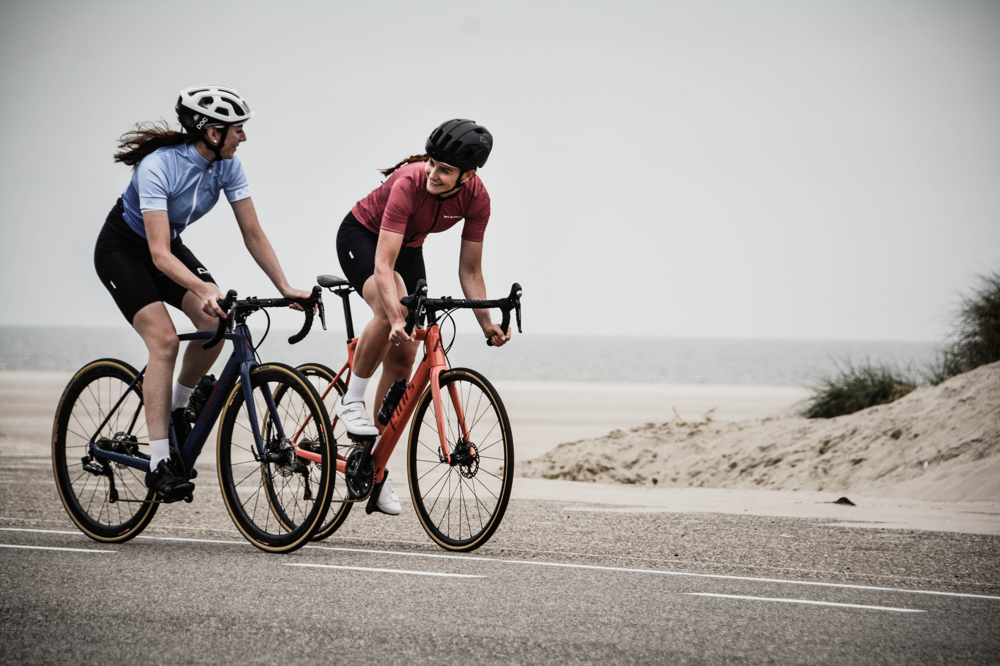

In [18]:
display(raw_image)

In [19]:
captions = model.generate({"image": image}, use_nucleus_sampling=True, num_captions=5)

In [20]:
for caption in captions:
    print(caption)

two people riding bikes on the street near sand dunes
two women on bikes in the middle of the road near sand dunes
two people riding bikes in the middle of the road
two people riding bikes on the side of a road
two bicyclists are racing on the road


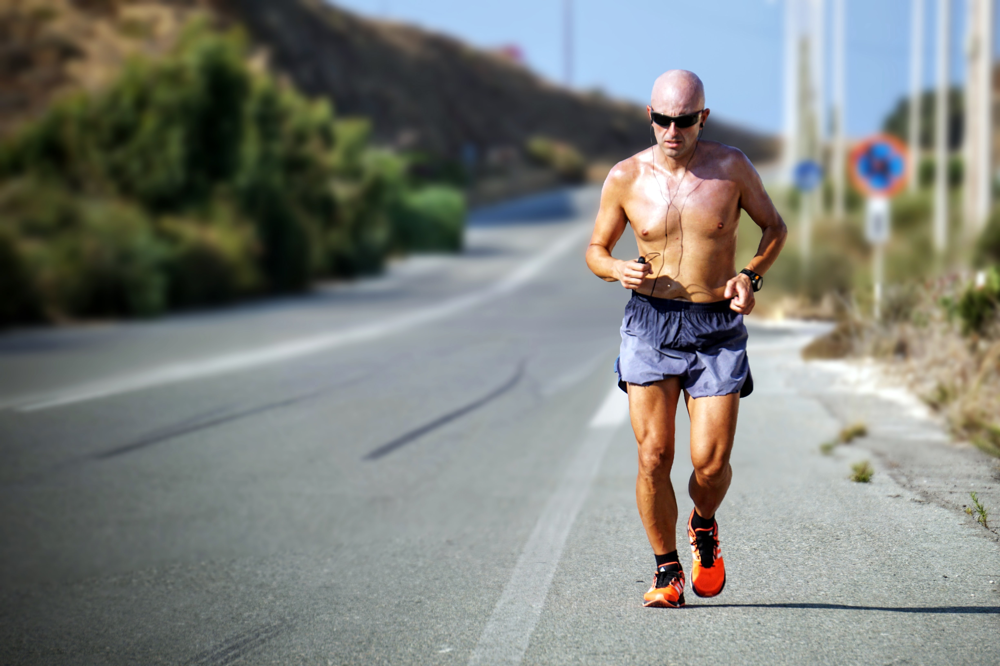

In [21]:
raw_image = Image.open('assets/maarten-van-den-heuvel-ky1w7eac5EM-unsplash.jpg')
image = vis_processors["eval"](raw_image).unsqueeze(0).to(device)
display(raw_image)

In [22]:
captions = model.generate({"image": image}, use_nucleus_sampling=True, num_captions=5)
for caption in captions:
    print(caption)

a man running in the road is barefoot
a man running on a road while wearing no shirt
a man running in the road with his sunglasses on
a man with a bald head running on a road
a man running on a road in the middle of the day
